<a href="https://colab.research.google.com/github/Kate777-hue/ADpredict/blob/main/6300_Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#DATA 6300 Final Project Overview


### Exploratory Data Analysis (EDA)
- Analyze the relationships between features and the target variable (` Diagnosis`) to uncover meaningful patterns and trends.

### Data Preprocessing
- Remove irrelevant features, including PatientID and  DoctorInCharge.


### Model Development
- Train Baseline Models:
  - Logistic Regression
  - Support Vector Machine
  - Random Forest
  - XGBoost
- Train Ensemble Models
  - Voting
  - Stacking
- Analyze Feature Importance
- Hyperparameter Tuning


### Model Evaluation
- Evaluate models using Accuracy, Precision, Recall, F1 Score.
- Compare performance across models to identify the best balance between parameters and generalization.

#Import Relevant Libraries

In [ ]:
from google.colab import files
import numpy as np
import pandas as pd
import statsmodels.api as sm
from matplotlib.pyplot import subplots
import sklearn.model_selection as skm
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import joblib
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, VotingClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import StackingClassifier
from sklearn.model_selection import RandomizedSearchCV , GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import roc_curve, auc
import random
import tensorflow as tf
import torch


SEED = 42
np.random.seed(SEED)
random.seed(SEED)
tf.random.set_seed(SEED)
torch.manual_seed(SEED)


In [ ]:
#!pip install pandas_profiling
!pip install -U ydata-profiling

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.1/400.1 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 17.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 687.8/687.8 kB 27.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.2/43.2 kB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 77.8 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=36d37666ed4556a4a37d2c034d543187a8226f5db09f15f75d657fb7254b3449
  Stored in directory: /root/.cache/pip/wheels/8d/55/1a/19cd535375ed1ede0c996405ebffe34b196d78e2d9545723a2
Successfully built htmlmin


In [ ]:
from ydata_profiling import ProfileReport

#Import Data

In [ ]:
# Import the data using google colab
from google.colab import files
uploaded = files.upload()

Saving alzheimers_disease_data.csv to alzheimers_disease_data.csv


In [ ]:
# Load dataset
df = pd.read_csv('alzheimers_disease_data.csv')

In [ ]:
#Display basic info
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2149 entries, 0 to 2148
Data columns (total 35 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   PatientID                  2149 non-null   int64  
 1   Age                        2149 non-null   int64  
 2   Gender                     2149 non-null   int64  
 3   Ethnicity                  2149 non-null   int64  
 4   EducationLevel             2149 non-null   int64  
 5   BMI                        2149 non-null   float64
 6   Smoking                    2149 non-null   int64  
 7   AlcoholConsumption         2149 non-null   float64
 8   PhysicalActivity           2149 non-null   float64
 9   DietQuality                2149 non-null   float64
 10  SleepQuality               2149 non-null   float64
 11  FamilyHistoryAlzheimers    2149 non-null   int64  
 12  CardiovascularDisease      2149 non-null   int64  
 13  Diabetes                   2149 non-null   int64

#Exploratory Data Analysis

In [ ]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 35/35 [00:01<00:00, 25.14it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

##Overview

From the overview, we can see that there are 35 features with 2149 observations,including 16 numerical variables and 19 categorical variables. Let's analyze them individually.

**Patient Information**

1.   **PatientID** is an irrelvant variable and can be removed from our dataset

**Demographic Details**

2.  **Age** is a numerical variable with a mean of 74.9, ranging from 60 to 90. The distribution looks normal.

3.   **Gender** is categorical variable with 2 distinct values (0 represents Male and 1 represents Female) and is evenly distributed with almost 50% male and 50% female

4.   **Ethnicity** is a categorical variable with 4 distinct groups from 0 to 3 with 0 being the most common and 2 being least common (0 represents Caucasian, 1 represents African American, 2 represents Asian, 3 represents Other)

5.   **EducationLevel** is a categorical variable with 4 distinct groups from 0 to 3 with 1 being the most common and 3 being the least common (0 represents None, 1 represents High School, 2 represents Bachelor's, 3 represents Higher)

**Lifestyle Factors**
6.   **BMI** refers to Body Mass Index, is a numerical variable with a mean of 27.66, ranging from 15.01 to 40.00. The distribution looks normal.  

7.   **Smoking** is a categorical variable with 2 distinct values: 0 (No) and 1 (Yes). The count of '0' is significant higher than that of '1'
8.   **AlcoholConsumption**:Weekly alcohol consumption in units, numerical variable with a mean of 10.04, ranging from 0.002 to 19.989. The distribution looks normal.

9.   **PhysicalActivity**: Weekly physical activity in hours,numerical variable with mean of 4.92, ranging from 0.003 to 9.987. The distribution looks normal


10.   **DietQuality**: Diet quality score, numerical,  ranging from 0 to 10


11.   **SleepQuality**: Sleep quality score, numerical, ranging from 4 to 10

**Medical History**

12.   **FamilyHistoryAlzheimers**: Categorial variable. Family history of Alzheimer's Disease, where 0 indicates No and 1 indicates Yes.


13.   **CardiovascularDisease**：Categorical variable，where 0 indicates No and 1 indicates Yes

14.   **Diabetes**：Categorical variable，where 0 indicates No and 1 indicates Yes


15.   **Depression:**： Categorical variable，where 0 indicates No and 1 indicates Yes

16.   **HeadInjury**：Categorical variable，where 0 indicates No and 1 indicates Yes, Imbalance.

17.   **Hypertension**： Categorical variable，where 0 indicates No and 1 indicates Yes

**Clinical Measurements**

18.   **SystolicBP**：Numerical, Systolic blood pressure, ranging from 90 to 180 mmHg

19.   **DiastolicBP**：Numerical,Diastolic blood pressure, ranging from 60 to 120 mmHg.

20.   **CholesterolTotal**：Numerical,Total cholesterol levels, ranging from 150 to 300 mg/dL.

21.   **CholesterolLDL**：Numerical,Low-density lipoprotein cholesterol levels, ranging from 50 to 200 mg/dL

22.   **CholesterolHDL**：Numerical,High-density lipoprotein cholesterol levels, ranging from 20 to 100 mg/dL

23.   **CholesterolTriglycerides**：Numerical,Triglycerides levels, ranging from 50 to 400 mg/dL

**Cognitive and Functional Assessments**

24.   **MMSE**： Mini-Mental State Examination score, ranging from 0 to 30. Lower scores indicate cognitive impairment

25.   **FunctionalAssessment**：Functional assessment score, ranging from 0 to 10. Lower scores indicate greater impairment

26.   **MemoryComplaints**：Categorical, Presence of memory complaints, where 0 indicates No and 1 indicates Yes.


27.   **BehavioralProblems**：Categorical, Presence of behavioral problems, where 0 indicates No and 1 indicates Yes.


28.   **ADL**：Activities of Daily Living score, ranging from 0 to 10. Lower scores indicate greater impairment

**Symptoms**

29.   **Confusion**:  Categorical, Presence of confusion, where 0 indicates No and 1 indicates Yes.


30.   **Disorientation**:Categorical, Presence of disorientation, where 0 indicates No and 1 indicates Yes.


31.   **PersonalityChanges**: Categorical, Presence of personality changes, where 0 indicates No and 1 indicates Yes


32.   **DifficultyCompletingTasks**:Categorical, Presence of difficulty completing tasks, where 0 indicates No and 1 indicates Yes.

33.   **Forgetfulness**: Categorical,Presence of forgetfulness, where 0 indicates No and 1 indicates Yes

**Diagnosis Information**
34.   **Diagnosis**: Target variable, Diagnosis status for Alzheimer's Disease, where 0 indicates No and 1 indicates Yes

**Confidential Information**
35.   **DoctorInCharge**: Categorical, Constant.This column contains confidential information about the doctor in charge, with "XXXConfid" as the value for all patients.








##Interaction and Correlation

From the interaction and correlation plot, we can see that there is no strong interaction and correlation between variables

## Missing Value

From the dataset info and visualization of nullity by column, we can see that there is no missing values in each variable.

#Feature Engineering

Given the above EDA, we will drop the following:


1.   PatientID, since it's an irrelvant variable for modelling
2.   DoctorInCharge, since it is a constant with only one unique value



In [ ]:
# Drop the specified columns

df.drop(['PatientID', 'DoctorInCharge'], axis=1, inplace=True)

# Display the first few rows to verify the columns are dropped
print(df.head())


   Age  Gender  Ethnicity  EducationLevel        BMI  Smoking  \
0   73       0          0               2  22.927749        0   
1   89       0          0               0  26.827681        0   
2   73       0          3               1  17.795882        0   
3   74       1          0               1  33.800817        1   
4   89       0          0               0  20.716974        0   

   AlcoholConsumption  PhysicalActivity  DietQuality  SleepQuality  ...  \
0           13.297218          6.327112     1.347214      9.025679  ...   
1            4.542524          7.619885     0.518767      7.151293  ...   
2           19.555085          7.844988     1.826335      9.673574  ...   
3           12.209266          8.428001     7.435604      8.392554  ...   
4           18.454356          6.310461     0.795498      5.597238  ...   

   FunctionalAssessment  MemoryComplaints  BehavioralProblems       ADL  \
0              6.518877                 0                   0  1.725883   
1       

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2149 entries, 0 to 2148
Data columns (total 33 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Age                        2149 non-null   int64  
 1   Gender                     2149 non-null   int64  
 2   Ethnicity                  2149 non-null   int64  
 3   EducationLevel             2149 non-null   int64  
 4   BMI                        2149 non-null   float64
 5   Smoking                    2149 non-null   int64  
 6   AlcoholConsumption         2149 non-null   float64
 7   PhysicalActivity           2149 non-null   float64
 8   DietQuality                2149 non-null   float64
 9   SleepQuality               2149 non-null   float64
 10  FamilyHistoryAlzheimers    2149 non-null   int64  
 11  CardiovascularDisease      2149 non-null   int64  
 12  Diabetes                   2149 non-null   int64  
 13  Depression                 2149 non-null   int64

# Data Preprocessing

##Define Features and Target

In [ ]:
X = df.drop('Diagnosis', axis=1)
y = df['Diagnosis']

##Separate Numercial and categorical variables

In [ ]:
# Define a threshold: if a numeric column has fewer unique values than this, consider it categorical.
unique_threshold = 10

numerical_vars = []
categorical_vars = []

for col in X.columns:
    # Check if the column's datatype is numeric
    if pd.api.types.is_numeric_dtype(X[col]):
        unique_count = X[col].nunique()
        if unique_count < unique_threshold:
            categorical_vars.append(col)
        else:
            numerical_vars.append(col)
    else:
        # If not numeric, we assume it's categorical
        categorical_vars.append(col)

# Print the lists and their counts
print("Numerical Variables:", numerical_vars)
print("Count of Numerical Variables:", len(numerical_vars))
print("\nCategorical Variables:", categorical_vars)
print("Count of Categorical Variables:", len(categorical_vars))

Numerical Variables: ['Age', 'BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality', 'SleepQuality', 'SystolicBP', 'DiastolicBP', 'CholesterolTotal', 'CholesterolLDL', 'CholesterolHDL', 'CholesterolTriglycerides', 'MMSE', 'FunctionalAssessment', 'ADL']
Count of Numerical Variables: 15

Categorical Variables: ['Gender', 'Ethnicity', 'EducationLevel', 'Smoking', 'FamilyHistoryAlzheimers', 'CardiovascularDisease', 'Diabetes', 'Depression', 'HeadInjury', 'Hypertension', 'MemoryComplaints', 'BehavioralProblems', 'Confusion', 'Disorientation', 'PersonalityChanges', 'DifficultyCompletingTasks', 'Forgetfulness']
Count of Categorical Variables: 17


##Split the data into training and testing sets with 80% training set and 20% test set

In [ ]:
#split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)


##Feature scaling (Normalization) for Numerical variables

In [ ]:
# Create a copy of the training and testing data
X_train_scaled = X_train.copy()
X_test_scaled = X_test.copy()

# Initialize the scaler
scaler = StandardScaler()

# Fit the scaler on the numerical columns of the training set and transform them
#scaler.fit(X_train[numerical_vars])
#print("Mean:", scaler.mean_)
#print("Scale:", scaler.scale_)
#joblib.dump(scaler, "scaler_model.pkl")
#X_train_scaled[numerical_vars] = scaler.transform(X_train[numerical_vars])
X_train_scaled[numerical_vars] = scaler.fit_transform(X_train[numerical_vars])


# Transform the numerical columns of the testing set using the fitted scaler
X_test_scaled[numerical_vars] = scaler.fit_transform(X_test[numerical_vars])

# Optionally, print a few rows to verify
print("Scaled Training Data (first 5 rows):")
print(X_train_scaled.head())


Scaled Training Data (first 5 rows):
           Age  Gender  Ethnicity  EducationLevel       BMI  Smoking  \
1433  1.328523       1          2               1  0.010659        1   
630  -0.547367       0          0               3  1.305827        0   
78    0.776791       1          3               2 -1.634359        0   
366   0.114712       1          0               2  0.362836        1   
1996 -1.540486       0          0               2 -0.433186        1   

      AlcoholConsumption  PhysicalActivity  DietQuality  SleepQuality  ...  \
1433            1.136669         -1.648973     0.327959      0.454049  ...   
630            -1.492106          1.521599    -1.087222     -1.035466  ...   
78              1.099593         -1.070683     0.563772     -0.507425  ...   
366             0.317867          0.473723     0.424829     -0.121121  ...   
1996           -1.334000          1.781140    -1.005189     -1.321369  ...   

          MMSE  FunctionalAssessment  MemoryComplaints  Behav

## Save and Download train and test dataset

In [ ]:
# Combine scaled features with the target for the training set
train_data = X_train_scaled.copy()
train_data['Diagnosis'] = y_train

# Combine scaled features with the target for the test set
test_data = X_test_scaled.copy()
test_data['Diagnosis'] = y_test

# Save the training and testing datasets as CSV files
train_data.to_csv('train_dataset.csv', index=False)
test_data.to_csv('test_dataset.csv', index=False)

print("Training and testing datasets have been saved as 'train_dataset.csv' and 'test_dataset.csv'.")


Training and testing datasets have been saved as 'train_dataset.csv' and 'test_dataset.csv'.


In [ ]:
  #load saved files

files.download('train_dataset.csv')
files.download('test_dataset.csv')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#Modelling and Model Tuning

##Import processed datasets

In [ ]:
# Import the data using google colab
from google.colab import files
uploaded = files.upload()

Saving test_dataset.csv to test_dataset (1).csv
Saving train_dataset.csv to train_dataset (1).csv


In [ ]:
#load train data
train_data = pd.read_csv('train_dataset.csv')
train_data.info()

#load test data
test_data = pd.read_csv('test_dataset.csv')
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1719 entries, 0 to 1718
Data columns (total 33 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Age                        1719 non-null   float64
 1   Gender                     1719 non-null   int64  
 2   Ethnicity                  1719 non-null   int64  
 3   EducationLevel             1719 non-null   int64  
 4   BMI                        1719 non-null   float64
 5   Smoking                    1719 non-null   int64  
 6   AlcoholConsumption         1719 non-null   float64
 7   PhysicalActivity           1719 non-null   float64
 8   DietQuality                1719 non-null   float64
 9   SleepQuality               1719 non-null   float64
 10  FamilyHistoryAlzheimers    1719 non-null   int64  
 11  CardiovascularDisease      1719 non-null   int64  
 12  Diabetes                   1719 non-null   int64  
 13  Depression                 1719 non-null   int64

##Train Baseline Models


Define features and target

In [ ]:
# --- Separate features and target ---

X_train = train_data.drop('Diagnosis', axis=1)
y_train = train_data['Diagnosis']

X_test = test_data.drop('Diagnosis', axis=1)
y_test = test_data['Diagnosis']


Logistic Regression

In [ ]:
# --- Baseline Model 1: Logistic Regression ---
print("\n--- Logistic Regression ---")
lr = LogisticRegression(random_state=SEED, max_iter=1000)
lr.fit(X_train, y_train)
y_pred_lr = lr.predict(X_test)
print("Accuracy:", accuracy_score(y_test, y_pred_lr))
print("Classification Report:")
print(classification_report(y_test, y_pred_lr))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_lr))


--- Logistic Regression ---
Accuracy: 0.8302325581395349
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.90      0.87       277
           1       0.79      0.71      0.75       153

    accuracy                           0.83       430
   macro avg       0.82      0.80      0.81       430
weighted avg       0.83      0.83      0.83       430

Confusion Matrix:
[[248  29]
 [ 44 109]]


Support Vector Machine

In [ ]:
# --- Baseline Model 2: Support Vector Machines ---
print("\n--- Support Vector Machine ---")
svm = SVC(kernel='rbf', probability=True, random_state=SEED)
svm.fit(X_train, y_train)

y_pred_svm = svm.predict(X_test)
print("Accuracy:", accuracy_score(y_test, y_pred_svm))
print("Classification Report:")
print(classification_report(y_test, y_pred_svm))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_svm))


--- Support Vector Machine ---
Accuracy: 0.8395348837209302
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.92      0.88       277
           1       0.82      0.70      0.76       153

    accuracy                           0.84       430
   macro avg       0.83      0.81      0.82       430
weighted avg       0.84      0.84      0.84       430

Confusion Matrix:
[[254  23]
 [ 46 107]]


Random Forest

In [ ]:
# --- Baseline Model 3: Random Forest ---
print("\n--- Random Forest ---")
rf = RandomForestClassifier(random_state=SEED)
rf.fit(X_train, y_train)
y_pred_rf = rf.predict(X_test)
print("Accuracy:", accuracy_score(y_test, y_pred_rf))
print("Classification Report:")
print(classification_report(y_test, y_pred_rf))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_rf))


--- Random Forest ---
Accuracy: 0.9255813953488372
Classification Report:
              precision    recall  f1-score   support

           0       0.91      0.98      0.94       277
           1       0.96      0.82      0.89       153

    accuracy                           0.93       430
   macro avg       0.94      0.90      0.92       430
weighted avg       0.93      0.93      0.92       430

Confusion Matrix:
[[272   5]
 [ 27 126]]


Extreme Gradient Boost

In [ ]:
# --- Baseline Model 4: XGBoost ---
print("\n--- XGBoost ---")
xgb_model = XGBClassifier(random_state=SEED, eval_metric='logloss')
xgb_model.fit(X_train, y_train)
#xgb_model.save_model("xgb_model.json")

# --- Make predictions ---
y_pred_xgb = xgb_model.predict(X_test)

# --- Evaluate the model ---
print("XGBoost Accuracy:", accuracy_score(y_test, y_pred_xgb))
print("Classification Report:")
print(classification_report(y_test, y_pred_xgb))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_xgb))


--- XGBoost ---
XGBoost Accuracy: 0.9488372093023256
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96       277
           1       0.96      0.90      0.93       153

    accuracy                           0.95       430
   macro avg       0.95      0.94      0.94       430
weighted avg       0.95      0.95      0.95       430

Confusion Matrix:
[[271   6]
 [ 16 137]]


##Ensemble Model 1: Voting

In [ ]:
# Create Voting Classifier 1
# with Logistic Regression, Random Forest and XGBOOST

voting_ensemble_1 = VotingClassifier(
    estimators=[('lr', lr), ('rf', rf), ('xgb', xgb_model)],
    voting='hard'  # or use 'soft' if models support predict_proba()
)
voting_ensemble_1.fit(X_train, y_train)
y_pred_voting_1 = voting_ensemble_1.predict(X_test)

print("Voting Ensemble 1 Accuracy:", accuracy_score(y_test, y_pred_voting_1))
print("Classification Report for Voting Ensemble 1:")
print(classification_report(y_test, y_pred_voting_1))
print("Confusion Matrix for Voting Ensemble 1:")
print(confusion_matrix(y_test, y_pred_voting_1))

Voting Ensemble 1 Accuracy: 0.9325581395348838
Classification Report for Voting Ensemble 1:
              precision    recall  f1-score   support

           0       0.92      0.98      0.95       277
           1       0.96      0.85      0.90       153

    accuracy                           0.93       430
   macro avg       0.94      0.91      0.92       430
weighted avg       0.93      0.93      0.93       430

Confusion Matrix for Voting Ensemble 1:
[[271   6]
 [ 23 130]]


In [ ]:
# Create Voting Classifier 2
# with Logistic Regression, SVM, Random Forest and XGBOOST


voting_ensemble_2 = VotingClassifier(
    estimators=[('lr', lr), ('svm', svm), ('rf', rf),('xgb', xgb_model)],
    voting='hard'  # or use 'soft' if models support predict_proba()
)
voting_ensemble_2.fit(X_train, y_train)
y_pred_voting_2 = voting_ensemble_2.predict(X_test)

print("Voting Ensemble 2 Accuracy:", accuracy_score(y_test, y_pred_voting_2))
print("Classification Report for Voting Ensemble 2:")
print(classification_report(y_test, y_pred_voting_2))
print("Confusion Matrix for Voting Ensemble 2:")
print(confusion_matrix(y_test, y_pred_voting_2))

Voting Ensemble 2 Accuracy: 0.8976744186046511
Classification Report for Voting Ensemble 2:
              precision    recall  f1-score   support

           0       0.87      0.99      0.93       277
           1       0.97      0.74      0.84       153

    accuracy                           0.90       430
   macro avg       0.92      0.86      0.88       430
weighted avg       0.91      0.90      0.89       430

Confusion Matrix for Voting Ensemble 2:
[[273   4]
 [ 40 113]]


In [ ]:
# Create Voting Classifier 3
# with SVM, Random Forest and XGBOOST

voting_ensemble_3 = VotingClassifier(
    estimators=[('svm', svm), ('rf', rf),('xgb', xgb_model)],
    voting='hard'  # or use 'soft' if models support predict_proba()
)
voting_ensemble_3.fit(X_train, y_train)
y_pred_voting_3 = voting_ensemble_3.predict(X_test)

print("Voting Ensemble 3 Accuracy:", accuracy_score(y_test, y_pred_voting_3))
print("Classification Report for Voting Ensemble 3:")
print(classification_report(y_test, y_pred_voting_3))
print("Confusion Matrix for Voting Ensemble 3:")
print(confusion_matrix(y_test, y_pred_voting_3))

Voting Ensemble 3 Accuracy: 0.9372093023255814
Classification Report for Voting Ensemble 3:
              precision    recall  f1-score   support

           0       0.93      0.98      0.95       277
           1       0.96      0.86      0.91       153

    accuracy                           0.94       430
   macro avg       0.94      0.92      0.93       430
weighted avg       0.94      0.94      0.94       430

Confusion Matrix for Voting Ensemble 3:
[[272   5]
 [ 22 131]]


##Ensemble Model 2: Stacking



In [ ]:
# Create Stacking Ensemble 1
# with Logistic Regression, SVM, Random Forest and XGBOOST
# Meta-model- Logistic Regression

# Define base estimators (same as before)
estimators = [('lr',lr), ('svm', svm), ('rf', rf), ('xgb', xgb_model)]

# Define a meta-model for stacking (you can experiment with different models)
meta_model = LogisticRegression(max_iter=1000, random_state=SEED)

# Create Stacking Classifier ensemble
stacking_ensemble_1 = StackingClassifier(
    estimators=estimators,
    final_estimator=meta_model,
    cv=5  # 5-fold cross-validation for the meta-model
)
stacking_ensemble_1.fit(X_train, y_train)
y_pred_stacking_1 = stacking_ensemble_1.predict(X_test)

print("\nStacking Ensemble 1 Accuracy:", accuracy_score(y_test, y_pred_stacking_1))
print("Classification Report for Stacking Ensemble 1:")
print(classification_report(y_test, y_pred_stacking_1))
print("Confusion Matrix for Stacking Ensemble 1:")
print(confusion_matrix(y_test, y_pred_stacking_1))


Stacking Ensemble 1 Accuracy: 0.9488372093023256
Classification Report for Stacking Ensemble 1:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96       277
           1       0.96      0.90      0.93       153

    accuracy                           0.95       430
   macro avg       0.95      0.94      0.94       430
weighted avg       0.95      0.95      0.95       430

Confusion Matrix for Stacking Ensemble 1:
[[271   6]
 [ 16 137]]


In [ ]:
# Create Stacking Ensemble 2
# with Logistic Regression, SVC, Random Forest and XGBOOST
# Meta-model- SVC

# Define base estimators (same as before)
estimators = [('lr',lr), ('svm', svm), ('rf', rf), ('xgb', xgb_model)]

# Define a meta-model for stacking (you can experiment with different models)
meta_model = SVC(max_iter=1000, random_state=SEED)

# Create Stacking Classifier ensemble
stacking_ensemble_2 = StackingClassifier(
    estimators=estimators,
    final_estimator=meta_model,
    cv=5  # 5-fold cross-validation for the meta-model
)
stacking_ensemble_2.fit(X_train, y_train)
y_pred_stacking_2 = stacking_ensemble_2.predict(X_test)

print("\nStacking Ensemble 2 Accuracy:", accuracy_score(y_test, y_pred_stacking_2))
print("Classification Report for Stacking Ensemble 2:")
print(classification_report(y_test, y_pred_stacking_2))
print("Confusion Matrix for Stacking Ensemble 2:")
print(confusion_matrix(y_test, y_pred_stacking_2))


Stacking Ensemble 2 Accuracy: 0.9534883720930233
Classification Report for Stacking Ensemble 2:
              precision    recall  f1-score   support

           0       0.95      0.98      0.96       277
           1       0.96      0.91      0.93       153

    accuracy                           0.95       430
   macro avg       0.95      0.94      0.95       430
weighted avg       0.95      0.95      0.95       430

Confusion Matrix for Stacking Ensemble 2:
[[271   6]
 [ 14 139]]


In [ ]:
# Create Stacking Ensemble 3
# with Logistic Regression, SVM, Random Forest and XGBOOST
# Meta-model- Random Forest Classifier

# Define base estimators (same as before)
estimators = [('lr',lr), ('svm', svm), ('rf', rf), ('xgb', xgb_model)]

# Define a meta-model for stacking (you can experiment with different models)
meta_model = RandomForestClassifier(random_state=42)

# Create Stacking Classifier ensemble
stacking_ensemble_3 = StackingClassifier(
    estimators=estimators,
    final_estimator=meta_model,
    cv=5  # 5-fold cross-validation for the meta-model
)
stacking_ensemble_3.fit(X_train, y_train)
y_pred_stacking_3 = stacking_ensemble_3.predict(X_test)

print("\nStacking Ensemble 3 Accuracy:", accuracy_score(y_test, y_pred_stacking_3))
print("Classification Report for Stacking Ensemble 3:")
print(classification_report(y_test, y_pred_stacking_3))
print("Confusion Matrix for Stacking Ensemble 3:")
print(confusion_matrix(y_test, y_pred_stacking_3))


Stacking Ensemble 3 Accuracy: 0.9558139534883721
Classification Report for Stacking Ensemble 3:
              precision    recall  f1-score   support

           0       0.96      0.97      0.97       277
           1       0.95      0.92      0.94       153

    accuracy                           0.96       430
   macro avg       0.96      0.95      0.95       430
weighted avg       0.96      0.96      0.96       430

Confusion Matrix for Stacking Ensemble 3:
[[270   7]
 [ 12 141]]


In [ ]:
# Create Stacking Ensemble 4
# with Logistic Regression, Random Forest and XGBOOST
# Meta-model- Logistic Regression

estimators = [('lr', lr), ('rf', rf), ('xgb', xgb_model)]

# Define a meta-model for stacking (you can experiment with different models)
meta_model = LogisticRegression(random_state=SEED, max_iter=1000)

# Create Stacking Classifier ensemble
stacking_ensemble_4 = StackingClassifier(
    estimators=estimators,
    final_estimator=meta_model,
    cv=5  # 5-fold cross-validation for the meta-model
)
stacking_ensemble_4.fit(X_train, y_train)
y_pred_stacking_4 = stacking_ensemble_4.predict(X_test)

print("\nStacking Ensemble 4 Accuracy:", accuracy_score(y_test, y_pred_stacking_4))
print("Classification Report for Stacking Ensemble 4:")
print(classification_report(y_test, y_pred_stacking_4))
print("Confusion Matrix for Stacking Ensemble 4:")
print(confusion_matrix(y_test, y_pred_stacking_4))


Stacking Ensemble 4 Accuracy: 0.9488372093023256
Classification Report for Stacking Ensemble 4:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96       277
           1       0.96      0.90      0.93       153

    accuracy                           0.95       430
   macro avg       0.95      0.94      0.94       430
weighted avg       0.95      0.95      0.95       430

Confusion Matrix for Stacking Ensemble 4:
[[271   6]
 [ 16 137]]


##Model Evaluation

Performance Comparison Table:
                 Model  Accuracy  Precision    Recall  F1 Score
0  Logistic Regression  0.830233   0.789855  0.712418  0.749141
1                  SVM  0.841860   0.824427  0.705882  0.760563
2        Random Forest  0.927907   0.962121  0.830065  0.891228
3              XGBoost  0.948837   0.939597  0.915033  0.927152
4      Voting Ensemble  0.937209   0.950000  0.869281  0.907850
5    Stacking Ensemble  0.953488   0.940397  0.928105  0.934211


<ipython-input-77-e827f1d21bb6>:55: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
<ipython-input-77-e827f1d21bb6>:55: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
<ipython-input-77-e827f1d21bb6>:55: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
<ipython-input-77-e827f1d21bb6>:55: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")


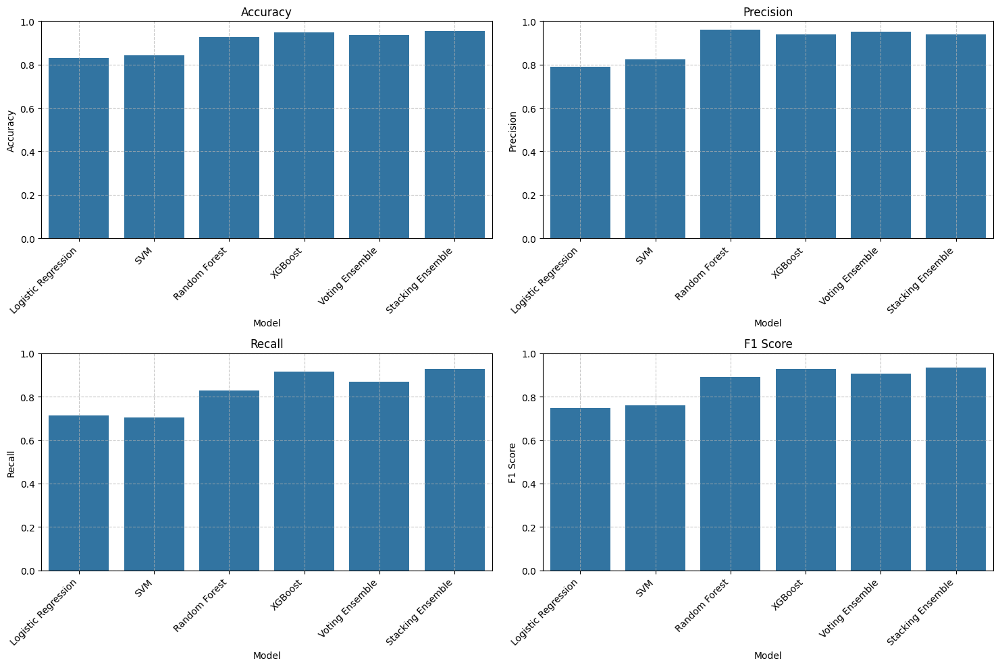

In [ ]:
# Create a dictionary of model predictions
model_predictions = {
    "Logistic Regression": y_pred_lr,
    "SVM": y_pred_svm,
    "Random Forest": y_pred_rf,
    "XGBoost": y_pred_xgb,
    "Voting Ensemble": y_pred_voting_3,
    "Stacking Ensemble": y_pred_stacking_3,

}

# Create a list to hold performance results for each model
results = []

# Compute evaluation metrics for each model
for model_name, y_pred in model_predictions.items():
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred, zero_division=0)
    rec = recall_score(y_test, y_pred, zero_division=0)
    f1 = f1_score(y_test, y_pred, zero_division=0)

    results.append({
        "Model": model_name,
        "Accuracy": acc,
        "Precision": prec,
        "Recall": rec,
        "F1 Score": f1
    })

# Convert results to a DataFrame for a neat tabular view
results_df = pd.DataFrame(results)
print("Performance Comparison Table:")
print(results_df)

# --- Visualization ---
# We can visualize each metric in a separate bar plot.
metrics = ["Accuracy", "Precision", "Recall", "F1 Score"]

fig, axes = plt.subplots(2, 2, figsize=(15, 10))
axes = axes.flatten()

for ax, metric in zip(axes, metrics):
    sns.barplot(x="Model", y=metric, data=results_df, ax=ax)
    ax.set_title(metric)
    ax.set_ylim(0, 1)  # Set limits between 0 and 1
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
    ax.grid(True, linestyle="--", alpha=0.7)

plt.tight_layout()
plt.show()


##Analyze Feature Importance using gain metric

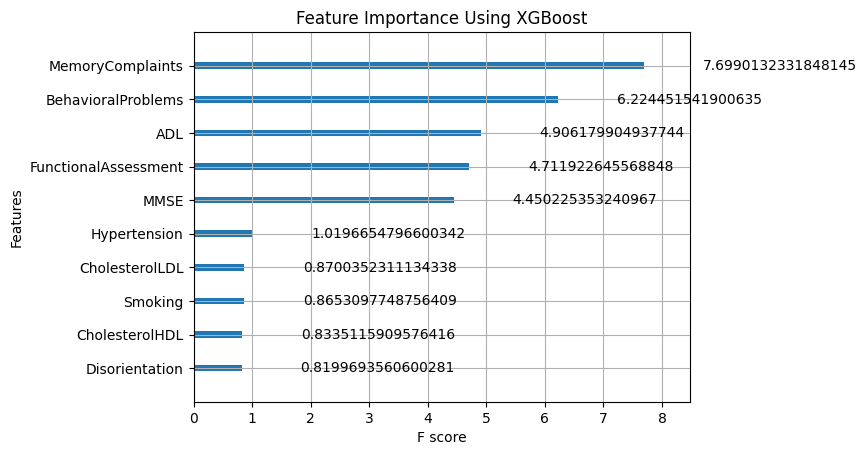

In [ ]:
import matplotlib.pyplot as plt
import xgboost as xgb


xgb.plot_importance(xgb_model, max_num_features=10, importance_type='gain')
plt.title("Feature Importance Using XGBoost")
plt.show()


##Hyperparameter Tuning


###Optimise Baseline Models Using GridSearchCV for the Best Model Performance

In [ ]:
# Search Best Parameters for Baseline Models

# Logistic Regression
lr_params = {
    'C': [0.01, 0.1, 1, 10, 100],  # Regularization strength
    'solver': ['liblinear', 'lbfgs', 'saga']
}

# SVC
svc_params = {
    'C': [0.1, 1, 10, 100],
    'kernel': ['linear', 'rbf', 'poly', 'sigmoid'],
    'gamma': ['scale', 'auto']
}

# Random Forest
rf_params = {
    'n_estimators': [50, 100, 200, 300, 500],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# XGBoost
xgb_params = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'subsample': [0.7, 0.8, 0.9],
    'colsample_bytree': [0.7, 0.8, 0.9]
}


In [ ]:
# Perform RandomizedSearchCV on each model
lr_search = RandomizedSearchCV(LogisticRegression(random_state=SEED), lr_params, cv=5, n_iter=10, random_state=SEED, n_jobs=-1)
svc_search = RandomizedSearchCV(SVC(probability=True, random_state=SEED), svc_params, cv=5, n_iter=10, random_state=SEED, n_jobs=-1)
rf_search = RandomizedSearchCV(RandomForestClassifier(random_state=SEED), rf_params, cv=5, n_iter=10, random_state=SEED, n_jobs=-1)
xgb_search = RandomizedSearchCV(XGBClassifier(random_state=SEED, eval_metric='mlogloss'), xgb_params, cv=5, n_iter=10, random_state=SEED, n_jobs=-1)

# Fit models
lr_search.fit(X_train, y_train)
svc_search.fit(X_train, y_train)
rf_search.fit(X_train, y_train)
xgb_search.fit(X_train, y_train)

# Get best models
best_lr = lr_search.best_estimator_
best_svc = svc_search.best_estimator_
best_rf = rf_search.best_estimator_
best_xgb = xgb_search.best_estimator_

# Print best parameters
print("Best Logistic Regression:", lr_search.best_params_)
print("Best SVC:", svc_search.best_params_)
print("Best Random Forest:", rf_search.best_params_)
print("Best XGBoost:", xgb_search.best_params_)


Best Logistic Regression: {'solver': 'saga', 'C': 1}
Best SVC: {'kernel': 'linear', 'gamma': 'scale', 'C': 1}
Best Random Forest: {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 2, 'max_depth': 20}
Best XGBoost: {'subsample': 0.9, 'n_estimators': 200, 'max_depth': 5, 'learning_rate': 0.2, 'colsample_bytree': 0.8}


### Predictions and Model Evaluation Based on Tunned Baseline Models

In [ ]:
# Generate predictions on the test set using tuned models
# ------------------------------------------------------
y_pred_tuned_lr = best_lr.predict(X_test)
y_pred_tuned_svc = best_svc.predict(X_test)
y_pred_tuned_rf = best_rf.predict(X_test)
y_pred_tuned_xgb = best_xgb.predict(X_test)

# --- Tuned Model Evaluations ---

print("### Tuned Models ###\n")

# Logistic Regression (Tuned)
print("Tuned Logistic Regression:")
print("Accuracy:", accuracy_score(y_test, y_pred_tuned_lr))
print("Classification Report:")
print(classification_report(y_test, y_pred_tuned_lr))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_tuned_lr))
print("\n------------------------\n")

# Support Vector Classifier (Tuned)
print("Tuned Support Vector Classifier:")
print("Accuracy:", accuracy_score(y_test, y_pred_tuned_svc))
print("Classification Report:")
print(classification_report(y_test, y_pred_tuned_svc))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_tuned_svc))
print("\n------------------------\n")

# Random Forest (Tuned)
print("Tuned Random Forest:")
print("Accuracy:", accuracy_score(y_test, y_pred_tuned_rf))
print("Classification Report:")
print(classification_report(y_test, y_pred_tuned_rf))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_tuned_rf))
print("\n------------------------\n")

# XGBoost (Tuned)
print("Tuned XGBoost:")
print("Accuracy:", accuracy_score(y_test, y_pred_tuned_xgb))
print("Classification Report:")
print(classification_report(y_test, y_pred_tuned_xgb))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_tuned_xgb))

### Tuned Models ###

Tuned Logistic Regression:
Accuracy: 0.8302325581395349
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.90      0.87       277
           1       0.79      0.71      0.75       153

    accuracy                           0.83       430
   macro avg       0.82      0.80      0.81       430
weighted avg       0.83      0.83      0.83       430

Confusion Matrix:
[[248  29]
 [ 44 109]]

------------------------

Tuned Support Vector Classifier:
Accuracy: 0.827906976744186
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.89      0.87       277
           1       0.78      0.71      0.75       153

    accuracy                           0.83       430
   macro avg       0.82      0.80      0.81       430
weighted avg       0.83      0.83      0.83       430

Confusion Matrix:
[[247  30]
 [ 44 109]]

------------------------

Tuned Random Forest:
Accu

###Ensemble Tuned Models

### Voting

In [ ]:

# --- Voting Ensemble with tuned base models ---
voting_ensemble_1 = VotingClassifier(
    estimators=[('lr', best_lr), ('rf', best_rf), ('xgb', best_xgb)],
    voting='hard'  # or 'soft'
)
voting_ensemble_1.fit(X_train, y_train)

# Predict using the tuned Voting1 Ensemble
y_pred_tuned_voting_1 = voting_ensemble_1.predict(X_test)
print("Voting Ensemble (tuned) Accuracy:", accuracy_score(y_test, y_pred_tuned_voting_1))
print(classification_report(y_test, y_pred_tuned_voting_1))


voting_ensemble_2 = VotingClassifier(
    estimators=[('lr', best_lr), ('svm', best_svc), ('rf', best_rf),('xgb', best_xgb)],
    voting='hard'  # or use 'soft' if models support predict_proba()
)
voting_ensemble_2.fit(X_train, y_train)
y_pred_voting_2 = voting_ensemble_2.predict(X_test)

print("Voting Ensemble 2 Accuracy:", accuracy_score(y_test, y_pred_voting_2))
print("Classification Report for Voting Ensemble 2:")
print(classification_report(y_test, y_pred_voting_2))


voting_ensemble_3 = VotingClassifier(
    estimators=[('svm', best_svc), ('rf', best_rf),('xgb', best_xgb)],
    voting='hard'  # or use 'soft' if models support predict_proba()
)
voting_ensemble_3.fit(X_train, y_train)
y_pred_voting_3 = voting_ensemble_3.predict(X_test)

print("Voting Ensemble 3 Accuracy:", accuracy_score(y_test, y_pred_voting_3))
print("Classification Report for Voting Ensemble 3:")
print(classification_report(y_test, y_pred_voting_3))


Voting Ensemble (tuned) Accuracy: 0.9348837209302325
              precision    recall  f1-score   support

           0       0.92      0.98      0.95       277
           1       0.96      0.86      0.90       153

    accuracy                           0.93       430
   macro avg       0.94      0.92      0.93       430
weighted avg       0.94      0.93      0.93       430

Voting Ensemble 2 Accuracy: 0.8813953488372093
Classification Report for Voting Ensemble 2:
              precision    recall  f1-score   support

           0       0.86      0.98      0.91       277
           1       0.96      0.70      0.81       153

    accuracy                           0.88       430
   macro avg       0.91      0.84      0.86       430
weighted avg       0.89      0.88      0.88       430

Voting Ensemble 3 Accuracy: 0.9348837209302325
Classification Report for Voting Ensemble 3:
              precision    recall  f1-score   support

           0       0.92      0.98      0.95       277


### Stacking

In [ ]:


# --- Stacking Ensemble with tuned base models ---

# Tuned Stacking Ensemble 1
stacking_ensemble_1= StackingClassifier(
    estimators=[('lr', best_lr), ('rf', best_rf), ('xgb', best_xgb)],
    final_estimator=LogisticRegression(random_state=SEED, max_iter=1000)
)
stacking_ensemble_1.fit(X_train, y_train)

# Predict using the tuned Stacking Ensemble
y_pred_tuned_stack_1 = stacking_ensemble_1.predict(X_test)
print("Stacking Ensemble (tuned) Accuracy:", accuracy_score(y_test, y_pred_tuned_stack_1))
print(classification_report(y_test, y_pred_tuned_stack_1))


# Tuned Stacking Ensemble 2
stacking_ensemble_2= StackingClassifier(
    estimators=[('lr', best_lr), ('rf', best_rf), ('xgb', best_xgb)],
    final_estimator=SVC(random_state=SEED, max_iter=1000)
)
stacking_ensemble_2.fit(X_train, y_train)

# Predict using the tuned Stacking Ensemble
y_pred_tuned_stack_2 = stacking_ensemble_2.predict(X_test)
print("Stacking Ensemble (tuned) Accuracy:", accuracy_score(y_test, y_pred_tuned_stack_2))
print(classification_report(y_test, y_pred_tuned_stack_2))


# Tuned Stacking Ensemble 3
stacking_ensemble_3= StackingClassifier(
    estimators=[('lr', best_lr), ('rf', best_rf), ('xgb', best_xgb)],
    final_estimator=RandomForestClassifier(random_state=SEED)
)

stacking_ensemble_3.fit(X_train, y_train)

# Predict using the tuned Stacking Ensemble
y_pred_tuned_stack_3 = stacking_ensemble_3.predict(X_test)
print("Stacking Ensemble (tuned) Accuracy:", accuracy_score(y_test, y_pred_tuned_stack_3))
print(classification_report(y_test, y_pred_tuned_stack_3))


Stacking Ensemble (tuned) Accuracy: 0.9441860465116279
              precision    recall  f1-score   support

           0       0.94      0.98      0.96       277
           1       0.96      0.88      0.92       153

    accuracy                           0.94       430
   macro avg       0.95      0.93      0.94       430
weighted avg       0.94      0.94      0.94       430

Stacking Ensemble (tuned) Accuracy: 0.9441860465116279
              precision    recall  f1-score   support

           0       0.94      0.98      0.96       277
           1       0.96      0.88      0.92       153

    accuracy                           0.94       430
   macro avg       0.95      0.93      0.94       430
weighted avg       0.94      0.94      0.94       430

Stacking Ensemble (tuned) Accuracy: 0.9418604651162791
              precision    recall  f1-score   support

           0       0.93      0.98      0.96       277
           1       0.96      0.87      0.91       153

    accuracy     

## Model Performance

In [ ]:
# Evaluate model performance with AUC/ROC

# List of models
models = {
    "Logistic Regression": best_lr,
    "SVC": best_svc,
    "Random Forest": best_rf,
    "XGBoost": best_xgb,
    "Voting Ensemble": voting_ensemble_1,
    "Stacking Ensemble": stacking_ensemble_1
}


Skipping ROC curve for Voting Ensemble as it does not have predict_proba.


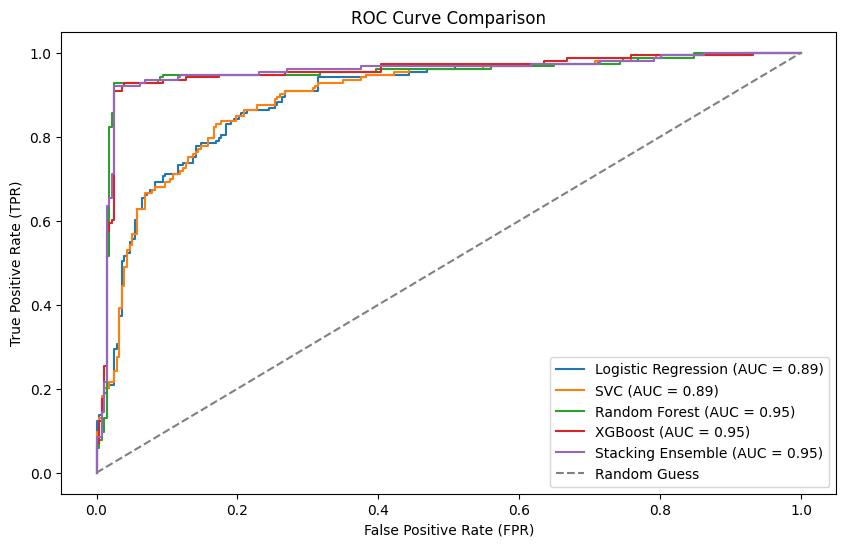

In [ ]:
# Plotting the Curve

plt.figure(figsize=(10, 6))

for model_name, model in models.items():
    # Check if the model has predict_proba
    if hasattr(model, 'predict_proba'):
        # Get probability scores
        y_prob = model.predict_proba(X_test)[:, 1]  # Select probabilities for positive class

        # Compute ROC curve
        fpr, tpr, _ = roc_curve(y_test, y_prob)
        roc_auc = auc(fpr, tpr)

        # Plot ROC curve
        plt.plot(fpr, tpr, label=f"{model_name} (AUC = {roc_auc:.2f})")
    else:
        print(f"Skipping ROC curve for {model_name} as it does not have predict_proba.")

# Plot random guess line
plt.plot([0, 1], [0, 1], linestyle="--", color="gray", label="Random Guess")

# Labels & Legend
plt.xlabel("False Positive Rate (FPR)")
plt.ylabel("True Positive Rate (TPR)")
plt.title("ROC Curve Comparison")
plt.legend()
plt.show()

# Final Model Evaluation

Performance Comparison Table:
                        Model  Accuracy  Precision    Recall  F1 Score
0               LR (baseline)  0.830233   0.789855  0.712418  0.749141
1              SVM (baseline)  0.839535   0.823077  0.699346  0.756184
2               RF (baseline)  0.925581   0.961832  0.823529  0.887324
3              XGB (baseline)  0.948837   0.958042  0.895425  0.925676
4                  LR (tuned)  0.830233   0.789855  0.712418  0.749141
5                 SVM (tuned)  0.827907   0.784173  0.712418  0.746575
6                  RF (tuned)  0.937209   0.963235  0.856209  0.906574
7                 XGB (tuned)  0.937209   0.950000  0.869281  0.907850
8           Voting (ensemble)  0.934884   0.956204  0.856209  0.903448
9         Stacking (ensemble)  0.955814   0.952703  0.921569  0.936877
10    Voting (tuned ensemble)  0.934884   0.956204  0.856209  0.903448
11  Stacking (tuned ensemble)  0.944186   0.957447  0.882353  0.918367


<ipython-input-47-2ee06697ae10>:54: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right", fontsize=12)
<ipython-input-47-2ee06697ae10>:54: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right", fontsize=12)
<ipython-input-47-2ee06697ae10>:54: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right", fontsize=12)
<ipython-input-47-2ee06697ae10>:54: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right", fontsize=12)


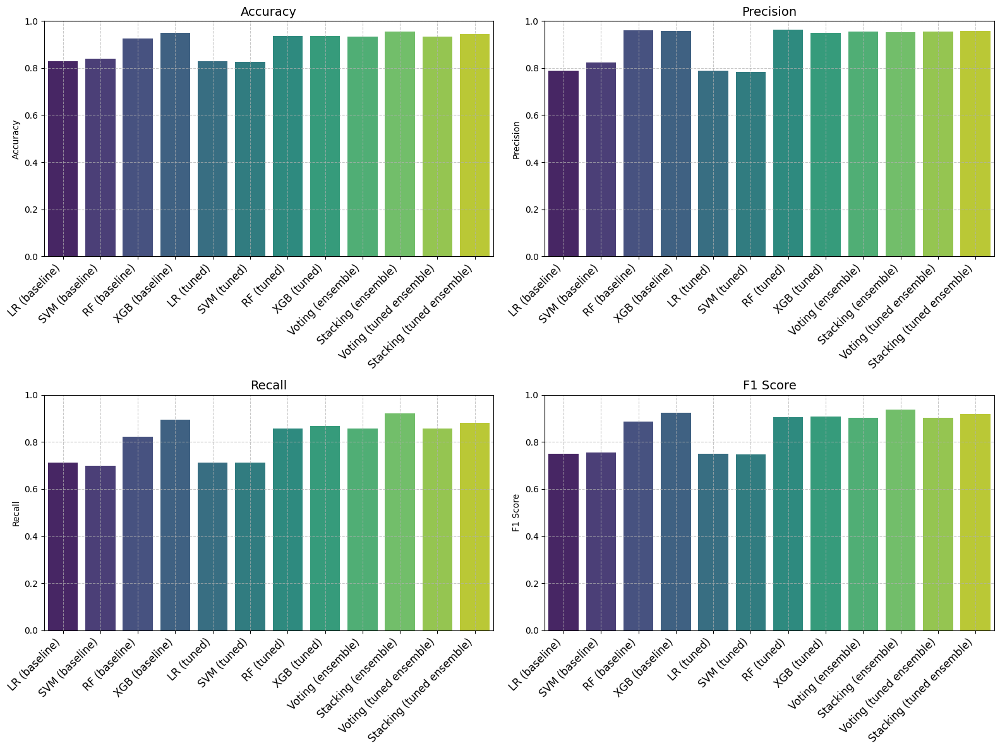

In [ ]:

# Create a dictionary mapping model names to their predictions
# ------------------------------
model_predictions = {
    "LR (baseline)": y_pred_lr,
    "SVM (baseline)": y_pred_svm,
    "RF (baseline)": y_pred_rf,
    "XGB (baseline)": y_pred_xgb,
    "LR (tuned)": y_pred_tuned_lr,
    "SVM (tuned)": y_pred_tuned_svc,
    "RF (tuned)": y_pred_tuned_rf,
    "XGB (tuned)": y_pred_tuned_xgb,
    "Voting (ensemble)": y_pred_voting_3,
    "Stacking (ensemble)": y_pred_stacking_3,
    "Voting (tuned ensemble)": y_pred_tuned_voting_1,
    "Stacking (tuned ensemble)": y_pred_tuned_stack_1
}

# ------------------------------
# Compute evaluation metrics for each model
# ------------------------------
results = []
for model_name, y_pred in model_predictions.items():
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred, zero_division=0)
    rec = recall_score(y_test, y_pred, zero_division=0)
    f1 = f1_score(y_test, y_pred, zero_division=0)

    results.append({
        "Model": model_name,
        "Accuracy": acc,
        "Precision": prec,
        "Recall": rec,
        "F1 Score": f1
    })

# Convert results to a DataFrame for a neat tabular view
results_df = pd.DataFrame(results)
print("Performance Comparison Table:")
print(results_df)

# ------------------------------
# Visualization of Metrics
# ------------------------------
# We'll create a 2x2 grid for the four metrics.
metrics = ["Accuracy", "Precision", "Recall", "F1 Score"]
fig, axes = plt.subplots(2, 2, figsize=(16, 12))
axes = axes.flatten()

for ax, metric in zip(axes, metrics):
    sns.barplot(x="Model", y=metric, data=results_df, ax=ax, hue="Model", palette="viridis", dodge=False, legend=False) # Changed here
    ax.set_title(metric, fontsize=14)
    ax.set_ylim(0, 1)
    ax.set_xlabel("")
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right", fontsize=12)
    ax.grid(True, linestyle="--", alpha=0.7)

plt.tight_layout()
plt.show()
